## Libraries

In [1]:
# Standard libraries
import itertools as it
import os
import sys
import nibabel as nib
import pandas as pd
from sklearn.ensemble import RandomForestRegressor
from joblib import dump, load
import time
import numpy as np
from glob import glob
import matplotlib.pyplot as plt
from numpy.random import randint
import subprocess
import tensorflow as tf
from tensorflow import keras
from sklearn.model_selection import train_test_split
import subprocess
import torch

## we will use a tool called c3d for pre-processing and augmenting MRI images into 3D patches: 
# !wget https://sourceforge.net/projects/c3d/files/c3d/Experimental/c3d-1.1.0-Linux-gcc64.tar.gz 
# !tar -xvzf c3d-1.1.0-Linux-gcc64.tar.gz 

## add to path:
os.environ['PATH'] = os.environ['PATH'] + ':' + os.path.realpath('c3d-1.1.0-Linux-gcc64/bin/')

2022-12-30 12:46:30.400132: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2022-12-30 12:46:30.553574: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /srv/software/itksnap/itksnap-3.8.2-alpha-20200410-Linux-gcc64-qt4/lib/snap-3.8.2-alpha:/srv/software/freesurfer/6.0.0/lib
2022-12-30 12:46:30.553607: I tensorflow/compiler/xla/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.
2022-12-30 12:46:32.161002: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64

## Functions

In [2]:
#defining a function that can help with using c3d which is a comman line based tool 
def c3d(args):
  """ 
  Runs c3d, taking arguments as a single string. 

  Inputs:
    args String: arguments to c3d command as a single string


  Example:

  To get usage info:
  > c3d('-h') 

  To get usage for a specific command:
  > c3d('-h extract-patches')

  """
  list_args = args.split(' ')
  print(list_args)
  cmd_list = ['c3d'] + list_args
  try:
    output = subprocess.check_output(cmd_list,
                                     stderr=subprocess.STDOUT)
  except subprocess.CalledProcessError as e:
    print(e.output.decode('utf-8'))
  else:
    print(output.decode("utf-8"))

In [3]:
def read_nii_metadata(nii_path):
    """Load in nifti data and header information and normalize MRI volume"""
    nii = nib.load(nii_path)
    nii_affine = nii.affine
    nii_data = nii.get_fdata()
    nii_data = (nii_data - nii_data.min())/ (nii_data.max() - nii_data.min())
    return nii_affine, nii_data

In [4]:
def get_fid(fcsv_path, fid_num):
    """Extract specific fiducial's spatial coordinates"""
    fcsv_df = pd.read_csv(fcsv_path, sep=",", header=2)
    return fcsv_df.loc[fid_num, ["x", "y", "z"]].to_numpy(dtype="single")

In [5]:
def fid_voxel2world(fid_voxel, nii_affine):
    """Transform fiducials in voxel coordinates to world coordinates"""

    # Translation
    fid_world = fid_voxel.T + nii_affine[:3, 3:4]
    # Rotation
    fid_world = np.dot(fid_voxel, nii_affine[:3, :3])

    return fid_world.astype(float)

In [6]:
def fid_world2voxel(fid_world, nii_affine, resample_size=1, padding=None):
    """Transform fiducials in world coordinates to voxel coordinates

    Optionally, resample to match resampled image
    """

    # Translation
    fid_voxel = fid_world.T - nii_affine[:3, 3:4]
    # Rotation
    fid_voxel = np.dot(fid_voxel, np.linalg.inv(nii_affine[:3, :3]))

    # Round to nearest voxel
    fid_voxel = np.rint(np.diag(fid_voxel) * resample_size)

    if padding:
        fid_voxel = np.pad(fid_voxel, padding, mode="constant")

    return fid_voxel.astype(int)

## Variables

In [9]:
#hyperparameters
batch_size = 10 #image data gen to read array generator from c3d*
frequency = 10 #sample 1 patch for every n voxels;

patch_radius= np.array([31,31,31]) #in voxels -- patch will be shape: 1+2*radius

#3D rotation augmentation; only for training set
num_augment = 2 #number of augmentations per patch
angle_stdev = 30 #stdev of normal distribution for sampling angle (in degrees)

#sampling radius
radius = patch_radius 

num_channels = 2 #to indicate that there is an accoriated distance map (in this case AFIDs distance map) --- allows for correct mapping between sampled patch and its corresponding distance map

#creating sampling radius argument (R0xR1xR2)
radius_arg = 'x'.join([str(rad) for rad in radius])

#patch shape = 1+2*radius
dims = 1+2*radius 
k = -3

PAD_FLAG = False
PADDING = 0
SIZE = 1  # Fixed for now but make variable

# Directories
USER="ataha" # my user on graham and robarts is different hence wont be using this
DATASET = 'OASIS'
BASE_DIR = f"/home/ROBARTS/ataha/graham/projects/ctb-akhanf/ataha24/5.afids_CNN"
RAW_BIDS = f'{BASE_DIR}/data/{DATASET}/bids'
RAW_AFIDS = f'{BASE_DIR}/data/{DATASET}/derivatives/afids_mni'
DER_DIR = f'/home/ROBARTS/ataha/graham/projects/ctb-akhanf/ataha24/5.afids_CNN/data/{DATASET}/derivatives'
SUBJECT_IDS = [subject for subject in os.listdir(RAW_BIDS) if "sub-" in subject]

#MNI stuff 
nii_path_mni = (f"{BASE_DIR}/resources/templates/tpl-MNI152NLin2009cAsym_res-01_T1w.nii.gz")
mni_aff, mni_img = read_nii_metadata(nii_path_mni)
fcsv_path_mni = f"{BASE_DIR}/resources/templates/tpl-MNI152NLin2009cAsym_res-01_T1w.fcsv"

## Pre-processing

In [8]:
#select afids, creating masks, probablity maps, etc
for sub in SUBJECT_IDS: 
    SUBJECT = sub
    T1W_BIDS_DIR = f'{RAW_BIDS}/{SUBJECT}/anat/{SUBJECT}_space-MNI152NLin2009cAsym_res-1mm_desc-synthstripnorm_T1w.nii.gz'
    !mkdir {DER_DIR}/c3d/{SUBJECT}
    df = pd.read_table(f'{RAW_AFIDS}/{SUBJECT}/{SUBJECT}_space-MNI152NLin2009cAsym_afids.fcsv',sep=',',header=2)
    df = df[['x','y','z']]
    df['value'] = 1
    for q in range(1,32):
      np.savetxt(f'{DER_DIR}/c3d/{SUBJECT}/{q}.txt', df.iloc[[q]].values) #reads .fcsv files for selected AFIDs and creates txt file for c3d 
      c3d (f'{T1W_BIDS_DIR} -scale 0 -landmarks-to-spheres {DER_DIR}/c3d/{SUBJECT}/{q}.txt 1 -o {DER_DIR}/c3d/{SUBJECT}/{q}.nii.gz') #uses the landmark file to create a thresthold image
      c3d (f'{DER_DIR}/c3d/{SUBJECT}/{q}.nii.gz -sdt -o {DER_DIR}/c3d/{SUBJECT}/{q}_prob.nii.gz') #uses threthold image to create needed Euclidean distance map 
      c3d (f'{DER_DIR}/c3d/{SUBJECT}/{q}_prob.nii.gz -scale {k} -exp -o {DER_DIR}/c3d/{SUBJECT}/{q}_prob_norm_{k*-1}.nii.gz') #normalizes map such that data follows e^-kx distribution
      c3d (f'{DER_DIR}/c3d/{SUBJECT}/{q}_prob.nii.gz -threshold 0 10 1 0 -o {DER_DIR}/c3d/{SUBJECT}/{q}_bin.nii') #creates a whole brain mask to sample 3D paches from

In [13]:
#extracting training data AFIDs maps and masks created in previous block
for FID_NUM in range(28,33): #some aready already done
    print(FID_NUM)
    for sub in SUBJECT_IDS: 
        SUBJECT = sub
        T1W_BIDS_DIR = f'{RAW_BIDS}/{SUBJECT}/anat/{SUBJECT}_space-MNI152NLin2009cAsym_res-1mm_desc-synthstripnorm_T1w.nii.gz'
        AFID_PROB_DIR= f'{DER_DIR}/c3d/{SUBJECT}/{FID_NUM -1}_prob.nii' #does not extract transformed ground truth maps rather raw ED from landmark! 
        MASK = f'{DER_DIR}/c3d/{SUBJECT}/{FID_NUM -1}_bin.nii'
        print(sub)
        c3d(f'{T1W_BIDS_DIR} {AFID_PROB_DIR} {MASK} -xpa {num_augment} {angle_stdev} -xp {DER_DIR}/c3d/{SUBJECT}/patch_{FID_NUM-1}_31_afids_all.dat {radius_arg} {frequency}')
    !cat /home/ROBARTS/ataha/graham/projects/ctb-akhanf/ataha24/5.afids_CNN/data/OASIS/derivatives/c3d/*/patch_{FID_NUM-1}_31_afids_all.dat > /home/ROBARTS/ataha/graham/projects/ctb-akhanf/ataha24/5.afids_CNN/data/OASIS/derivatives/c3d/all_patches_{FID_NUM-1}_train_all.dat

28
sub-0274
['/home/ROBARTS/ataha/graham/projects/ctb-akhanf/ataha24/5.afids_CNN/data/OASIS/bids/sub-0274/anat/sub-0274_space-MNI152NLin2009cAsym_res-1mm_desc-synthstripnorm_T1w.nii.gz', '/home/ROBARTS/ataha/graham/projects/ctb-akhanf/ataha24/5.afids_CNN/data/OASIS/derivatives/c3d/sub-0274/27_prob.nii', '/home/ROBARTS/ataha/graham/projects/ctb-akhanf/ataha24/5.afids_CNN/data/OASIS/derivatives/c3d/sub-0274/27_bin.nii', '-xpa', '2', '30', '-xp', '/home/ROBARTS/ataha/graham/projects/ctb-akhanf/ataha24/5.afids_CNN/data/OASIS/derivatives/c3d/sub-0274/patch_27_31_afids_all.dat', '31x31x31', '10']
-50.0704
0.906048,0.210461,0.274658,0.24361
0.730434 -0.325835 0.600248 0
0.557055 0.79272 -0.247557 0
-0.395166 0.515195 0.760538 0
0 0 0 1

-11.2069
0.995221,-0.0466625,-0.0653501,0.055553
0.985286 -0.104476 -0.13526 0
0.116674 0.989473 0.0856183 0
0.124891 -0.10014 0.987104 0
0 0 0 1

23.0309
0.979871,0.180941,-0.00723973,-0.0840301
0.985773 0.162057 -0.0445969 0
-0.167297 0.920399 -0.35338 0
-0.

In [11]:
#read patches in numpy array 
path_c3d = f'/project/6050199/ataha24/5.afids_CNN/data/OASIS/derivatives/c3d'
fname = f'{path_c3d}/all_patches_0_train_all.dat'
bps = 4 * num_channels * np.prod(dims)         # Bytes per sample
file_size = os.path.getsize(fname) 
num_samples = np.floor_divide(file_size,bps)   # Number of samples
print(file_size)
print(bps)
print(num_samples)

dims = dims.astype('int')
arr_shape_train = (int(num_samples),dims[0],dims[1],dims[2],num_channels)

arr_train = np.memmap(fname,'float32','r',shape=arr_shape_train)
arr_train = np.swapaxes(arr_train,1,3)
print(arr_shape_train)

88672667328
2000376
44328
(44328, 63, 63, 63, 2)


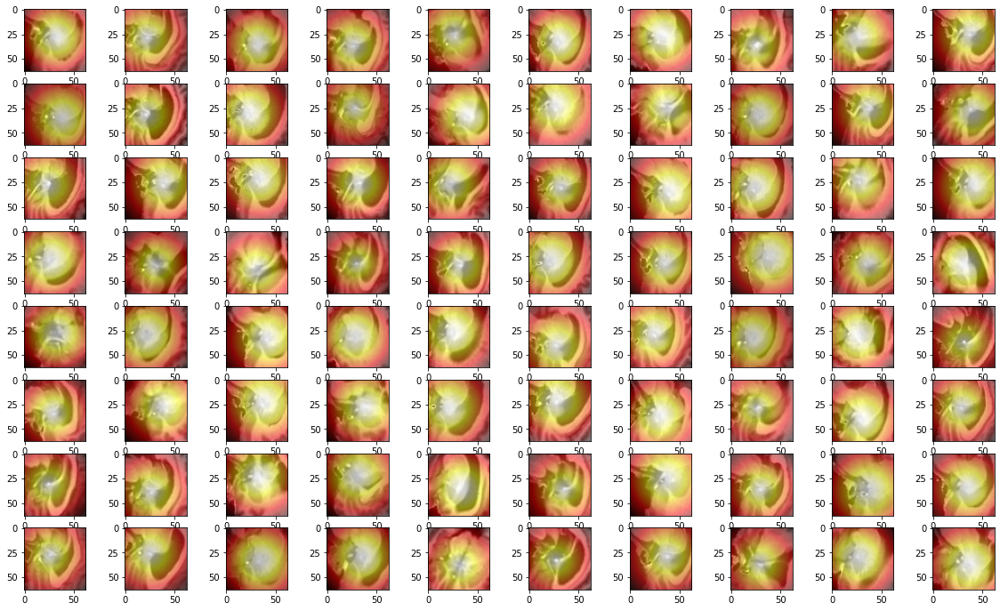

In [12]:
#Plot training patches with overlay at random images and samples:
plt.figure(figsize=(20,12))
nrows=8
ncols=10
for i,randi in enumerate(randint(low=0,high=arr_train.shape[0],size=(nrows*ncols,))):
  plt.subplot(nrows,ncols,i+1)
  plt.imshow(np.squeeze(arr_train[randi,40,:,:,0]),cmap='gray')
  plt.imshow(np.squeeze(arr_train[randi,40,:,:,1]),alpha=0.5,cmap="hot_r")